In [19]:
import pandas as pd
from pathlib import Path
import json
import numpy as np
import geopandas as gpd
import folium
import branca.colormap as cm
import libpysal
import matplotlib.pyplot as plt
from shapely.geometry import shape, Point

from libpysal.weights import Queen, Rook, KNN
import splot
from esda.moran import Moran
from splot.esda import moran_scatterplot

from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.preprocessing import StandardScaler

from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
import seaborn as sns

import matplotlib.pyplot as plt
plt.rcParams["font.family"] = "serif"

In [20]:
ROOT = Path.cwd().parent.parent
RAW = ROOT / 'data' / 'raw'
PROCESSED = ROOT / 'data' / 'processed'
OUT = ROOT / 'out'
ANALYSIS = ROOT / 'data' / 'analysis'

In [21]:
gdf = gpd.read_file(PROCESSED / 'predictors_msoa8.geojson', driver='GeoJSON')
print(gdf.shape)


(6855, 48)


# Run PCA

In [22]:
selected_vars = ['min_dist_road',
 'min_dist_rail',
 'min_dist_pua',
 'distance_km',
 'developed_res_area_pct',
 'agricultural_pct',
 'forest_pct',
 'road_pct',
 'public_transport_density',
 'area',
 'population',
 'population_density',
 'developed_wo_road_res_area_pct']
pca = PCA(n_components=len(selected_vars))
X = gdf[selected_vars]
scaler = StandardScaler()
scaler.fit(X)
X=scaler.transform(X)    

# pca_result = pca.fit_transform(X)
x_new = pca.fit_transform(X)
gdf[f'pca_1'] = x_new[:, 0]
gdf[f'pca_2'] = x_new[:, 1]

In [23]:
column_map = {
    "min_dist_road":"Min Distance to Road", 
    "min_dist_pua":"Min Distance to PUA",
    'min_dist_rail': "Min Distance to Rail",

    'distance_km': "Distance to City Centre",
    'area':"Area", 
    'population_density':"Population Density",
    'population': "Population",

    'developed_res_area_pct':"Residential Area (%)",
    'forest_area_pct': "Forested Area (%)",
    'agricultural_pct': "Agricultural Area (%)",  
    'developed_wo_road_res_area_pct': "Other Developed Area (%)",
    'commercial_area_pct': "Commercial Area (%)",
    'road_pct': "Road Area (%)",
    'forest_pct': "Forested Area (%)",
    
    'public_transport_density': "Public Transport Density", 
    
}



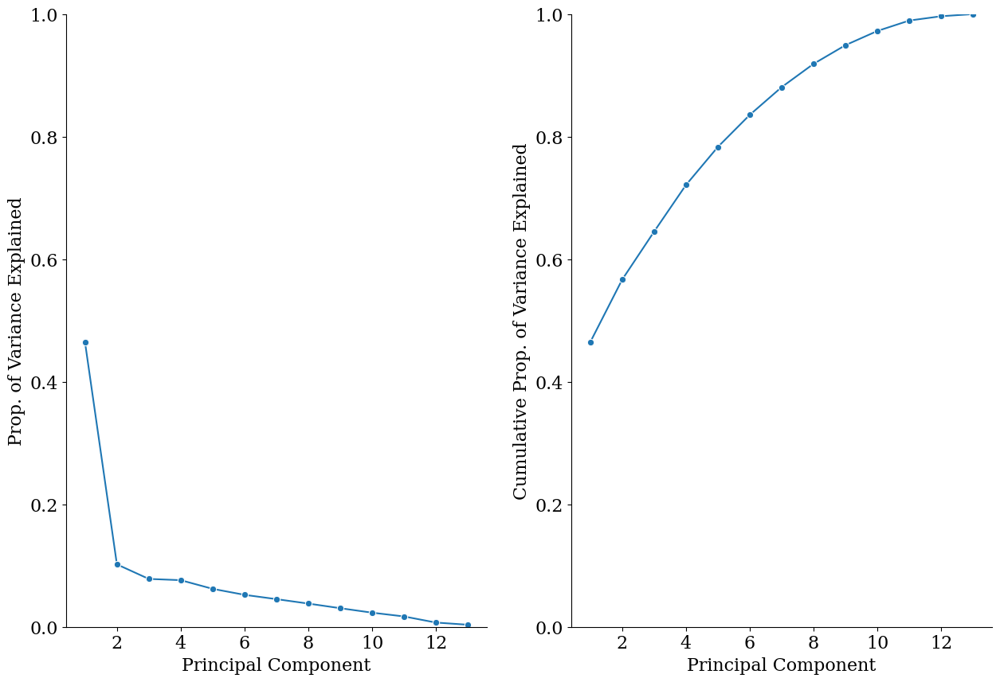

In [24]:
PC_values = np.arange(pca.n_components_) + 1
fig, ax = plt.subplots(1, 2, figsize=(15, 10))

sns.lineplot(x=PC_values, y=pca.explained_variance_ratio_, ax=ax[0], marker='o', )
ax[0].set_ylim(0, 1)
ax[0].set_ylabel('Prop. of Variance Explained')
ax[0].set_xlabel('Principal Component')

sns.lineplot(x=PC_values, y=np.cumsum(pca.explained_variance_ratio_), ax=ax[1], marker='o')
ax[1].set_ylim(0, 1)
ax[1].set_xlabel('Principal Component')
ax[1].set_ylabel('Cumulative Prop. of Variance Explained')

for a in [0, 1]:
    ax[a].spines['top'].set_visible(False)
    ax[a].spines['right'].set_visible(False)

fig.savefig(OUT / 'scree_plot.png', dpi=300, bbox_inches='tight')

In [25]:
df_prop_explained = pd.DataFrame(data={'Eigenvalue': pca.explained_variance_, 'Prop. of Explained Variance': pca.explained_variance_ratio_, 'Cumulative Prop. of Explained Variance': np.cumsum(pca.explained_variance_ratio_)}, index=range(1, pca.n_components_+1)) 
df_prop_explained = df_prop_explained.reset_index().rename(columns={'index': 'Principal Component'})
# df_prop_explained.to_csv(OUT / "pca_explained_variance.csv", index=False)
df_prop_explained

,Principal Component,Eigenvalue,Prop. of Explained Variance,Cumulative Prop. of Explained Variance
0,1,6.040673,0.464599,0.464599
1,2,1.326647,0.102035,0.566634
2,3,1.017603,0.078266,0.644900
3,4,0.990854,0.076208,0.721108
4,5,0.807245,0.062087,0.783195
5,6,0.679985,0.052299,0.835494
6,7,0.588535,0.045265,0.880759
7,8,0.494332,0.038020,0.918779
8,9,0.396373,0.030486,0.949265
9,10,0.301328,0.023176,0.972441


In [26]:
df = pd.DataFrame(pca.components_[0:2, :].T, columns=['PC1', 'PC2'], index=selected_vars)
df['abs_PC1'] = df['PC1'].abs()
df = df.sort_values(by='abs_PC1', ascending=False)
df = df.drop(columns='abs_PC1').reset_index()
df = df.rename(columns={'index':'Variable'})
df['Variable'] = df['Variable'].map(column_map) 
# df.to_csv(OUT / "pca_loadings.csv", index=False)
df

,Variable,PC1,PC2
0,Road Area (%),-0.377684,0.145669
1,Residential Area (%),-0.354260,0.205833
2,Agricultural Area (%),0.353448,-0.012990
3,Public Transport Density,-0.333266,0.187182
4,Population Density,-0.332807,0.233075
5,Other Developed Area (%),-0.277370,0.071414
6,Min Distance to Rail,0.261496,0.210475
7,Area,0.260494,0.267013
8,Distance to City Centre,0.235720,0.070482
9,Forested Area (%),0.229703,-0.167952


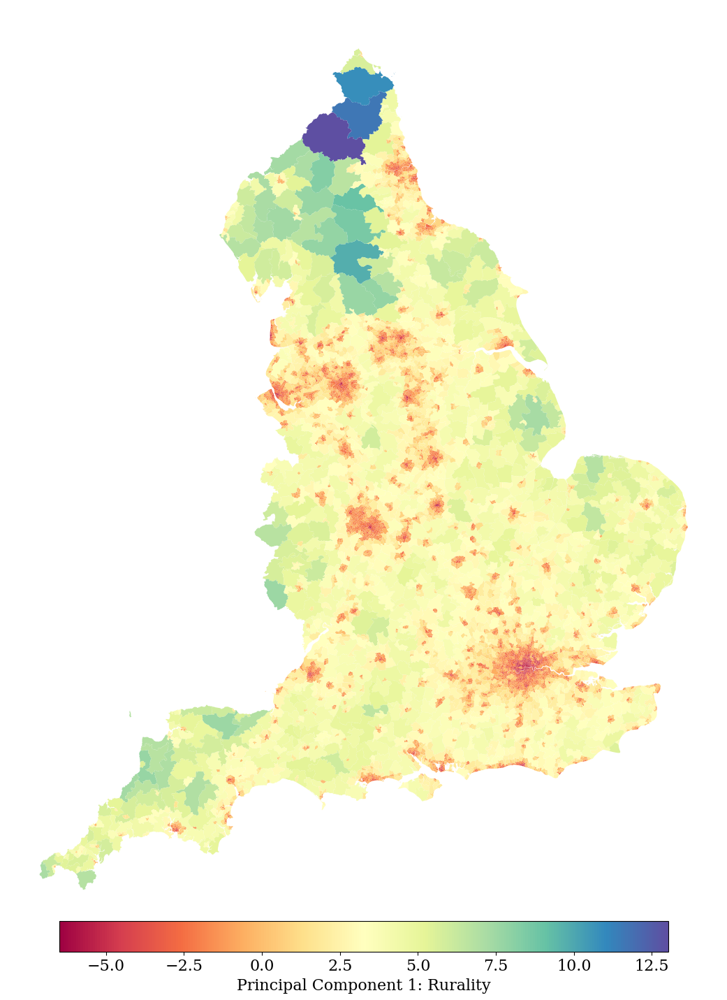

In [27]:
import matplotlib
# fig, ax = plt.subplots(figsize=(15, 20))
font = {
    # 'family' : 'normal',
    # 'weight' : 'bold',
    'size'   : 16
}
matplotlib.rc('font', **font)
pc=0
fig, ax = plt.subplots(1, figsize=(15, 20))
text = ['Rurality', "Remoteness"]
gdf.plot(
    column=f'pca_{pc+1}', 
    # cmap="RdYlBu",
    cmap="Spectral", 
    ax=ax,
    # title=f'PCA {pc+1}',
    legend=True,
    legend_kwds={'label': f'Principal Component {pc+1}: {text[pc]}', 'orientation': 'horizontal', 'shrink': 0.75, 'pad': -0.01}
)
ax.axis('off')
# ax.title.set_text(f'{text[pc]}')
# ax.title.set_size(20)
fig.savefig(OUT / f"pca_{pc+1}_map.png", dpi=500, bbox_inches='tight')

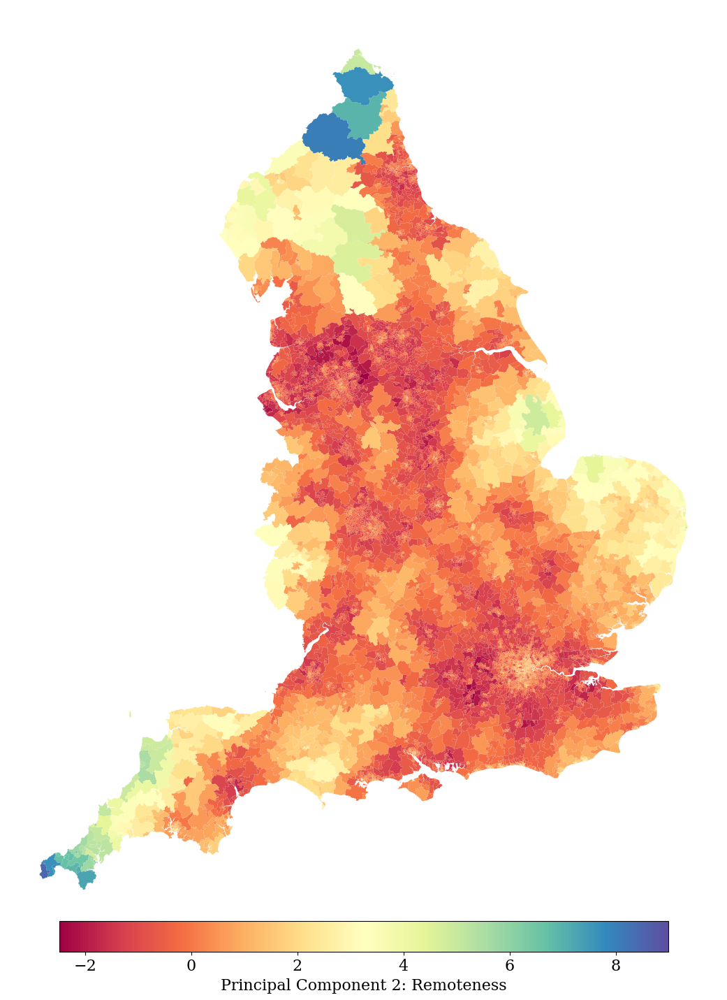

In [28]:
pc=1
fig, ax = plt.subplots(1, figsize=(15, 20))
gdf.plot(
    column=f'pca_{pc+1}', 
    cmap="Spectral", 
    ax=ax,
    # title=f'PCA {pc+1}',
    legend=True,
    legend_kwds={'label': f'Principal Component {pc+1}: {text[pc]}', 'orientation': 'horizontal', 'shrink': 0.75, 'pad': -0.01}
)
ax.axis('off')
# ax.title.set_text(f'{text[pc]}')
# ax.title.set_size(20)
fig.savefig(OUT / f"pca_{pc+1}_map.png", dpi=500, bbox_inches='tight')

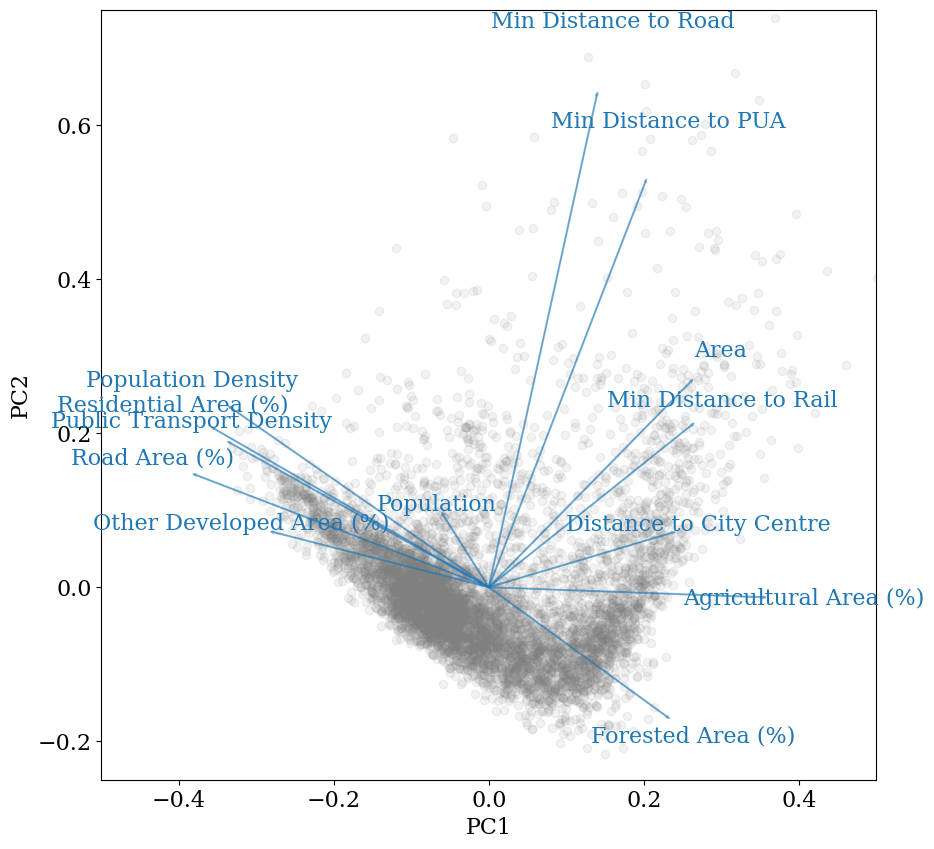

In [29]:
def myplot(score,coeff,labels=None):
    xs = score[:,0]
    ys = score[:,1]
    n = coeff.shape[0]
    scalex = 1.0/(xs.max() - xs.min())
    scaley = 1.0/(ys.max() - ys.min())
    # f = plt.figure(figsize=(8, 8), dpi=80)
    plt.scatter(xs * scalex,ys * scaley, alpha=0.1, color='grey')
    for i in range(n):
        plt.arrow(0, 0, coeff[i,0], coeff[i,1],color = '#1f77b4',alpha = 0.5)
        if labels is None:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, "Var"+str(i+1), color = '#1f77b4', ha = 'center', va = 'center')
        else:
            plt.text(coeff[i,0]* 1.15, coeff[i,1] * 1.15, labels[i], color = '#1f77b4', ha = 'center', va = 'center')
    # return f

plt.xlim(-0.5,0.5)
plt.ylim(-0.25,0.75)
plt.xlabel("PC{}".format(1))
plt.ylabel("PC{}".format(2))
plt.grid()

fig = myplot(
    gdf.loc[: ,[f'pca_1', f'pca_2']].to_numpy(),
    np.transpose(pca.components_[0:2, :]), 
    labels=[column_map.get(i) for i in selected_vars]
)
plt.gcf().set_size_inches((10, 10))    
plt.grid(False)



# Run the clustering

In [30]:
# GMM

##

n_components = 8
X_cluster = gdf[[
    f'pca_1', 
    f'pca_2', 
]].to_numpy()
gmm = GaussianMixture(
    n_components=n_components,
    n_init=20,
    random_state=42,
)
gmm.fit(X_cluster)
gdf[f'cluster_gmm'] = gmm.predict(X_cluster)

gmm = GaussianMixture(
    n_components=10,
    n_init=20,
    random_state=42,
)
gmm.fit(X_cluster)
gdf[f'cluster_gmm_2'] = gmm.predict(X_cluster)

# n_components = 12
# X_cluster = gdf[[
#     f'pca_1', 
#     f'pca_2', 
# ]].to_numpy()
# gmm = GaussianMixture(
#     n_components=n_components,
#     n_init=20,
#     random_state=42,
# )
# gmm.fit(X_cluster)
# gdf[f'cluster_gmm_2'] = gmm.predict(X_cluster)

# KMEANS
km = KMeans(
    n_clusters=8,
    n_init=20,
    random_state=42,
)
km.fit(X_cluster)
clusters = km.predict(X_cluster)
gdf['cluster_km_1'] = clusters

# do it again with 10 centroids
km2 = KMeans(
    n_clusters=10,
    n_init=20,
    random_state=42,
)
km2.fit(X_cluster)
clusters = km2.predict(X_cluster)
gdf['cluster_km_2'] = clusters


In [31]:
# GMMM

cluster_map = {
    4: "Urban 1",
    0: "Urban 2",
    7: "Urban 3 (Suburban)",
    3: "Urban 4 (Outer)",
    6: "Urban 5 (Remote)",
    1: "Rural 1 (Connected)",
    2: "Rural 2",
    5: "Rural 3 (Remote)"
}
# cols = ['#a50026','#d73027','#f46d43','#fdae61','#fee090','#abd9e9','#74add1','#4575b4']

cols = ['#a50026','#d73027','#f46d43','#fdae61','#fee090','#74add1','#4575B4', '#334A9D']
cluster_map = {k: (v, cols[i]) for i, (k, v) in enumerate(cluster_map.items())}
colour_map = {v[0]:cols[i] for i, (k, v) in enumerate(cluster_map.items())}
gdf['helper'] = gdf[f'cluster_gmm'].map(cluster_map)
gdf[['cluster_name_gmm', 'cluster_color_gmm']] = pd.DataFrame(gdf['helper'].tolist(), index=gdf.index)
# gdf.explore(color='cluster_color_gmm', tiles='cartodbpositron', style_kwds={"weight":0, "fillOpacity": 0.9}, highlight=False)

In [32]:

kmeans_colmap = {
    4: '#a51225',
    5: "#c54b2c",
    2: "#dc783e",
    7: '#eaa15c', # this could be urban... looks like greenbelt, they're the sort of commuter towns.. 
        # they're the most borderline cases I think
    0: '#f2c786', # the remote kind
    1: '#74add1',
    
    3: "#4575b4",
    6: "#334A9D",

}
kmeans_cluster_map = {
    4: "Urban 1 (Inner Central)",
    5: "Urban 2 (Outer Central)",
    2: "Urban 3 (Suburban)",
    7: "Urban 4 (Small town or periphery)",
    0: "Urban 5 (Remote)",
    1: "Rural 1 (Connected)",
    3: "Rural 2",
    6: "Rural 3 (Remote)"
}
kmeans_colmap2 = {
     "Urban 1 (Inner Central)": '#a51225',
    "Urban 2 (Outer Central)": "#c54b2c",
     "Urban 3 (Suburban)": "#dc783e",
    "Urban 4 (Small town or periphery)": '#eaa15c', 
    "Urban 5 (Remote)": '#f2c786',
    "Rural 1 (Connected)": '#74add1',
    "Rural 2": "#4575b4",
    "Rural 3 (Remote)": "#334A9D",
}
# cols = ['#a50026','#d73027','#f46d43','#fdae61','#fee090','#abd9e9','#74add1','#4575b4']
gdf['cluster_color_km_1'] = gdf['cluster_km_1'].map(kmeans_colmap)
gdf['cluster_name_km_1'] = gdf['cluster_km_1'].map(kmeans_cluster_map)


In [33]:

gdf[['geometry', 'cluster_km_2']].explore('cluster_km_2')
km_2_map = {
    0: "Urban 1",
    3: "Urban 2",
    5: "Urban 3",
    7: "Urban 4",
    1: "Urban 5",
    8: "Urban 6",
    2: "Rural 1",
    9: "Rural 2",
    4: "Rural 3",
    6: "Rural 4",
}

urban_colors = ['#a51225','#c54b2c','#dc783e','#eaa15c', '#f2c786', '#fbe9b7']
rural_colors = ['#abd9e9', '#74add1','#4575B4', '#334A9D']
km2_cols = urban_colors + rural_colors
km2_colmap = {v: km2_cols[i] for i, v in enumerate(km_2_map.values())}
gdf['cluster_name_km_2'] = gdf['cluster_km_2'].map(km_2_map)
gdf['cluster_color_km_2'] = gdf['cluster_name_km_2'].map(km2_colmap)

In [34]:
gdf.columns
gdf_export = gdf[[
    'msoa',
    'geometry',
    'population',
    'population_under_12',
    'area',
    'road_pct',
    'population_density',
    'rural_urban_category',
    'primary',
    'school_capacity',
    'pca_1', 'pca_2', 'cluster_gmm', 'cluster_gmm_2', 'cluster_km_1' ,
    'cluster_name_gmm', 'cluster_color_gmm', 'cluster_color_km_1', 'cluster_name_km_1',
    'cluster_name_km_2', 'cluster_color_km_2', 'cluster_km_2'
]]

# Adjusted to have a darker blue colour for defra
gdf_export['cluster_color_defra'] = gdf_export['rural_urban_category'].map({
    "Urban major conurbation": '#a51225',
    'Urban minor conurbation': '#c54b2c',
    'Urban city and town': '#dc783e',
    'Urban city and town in a sparse setting': '#eaa15c',
    'Rural town and fringe': '#abd9e9',
    'Rural town and fringe in a sparse setting': '#74add1',
    'Rural village and dispersed': '#4575b4',
    'Rural village and dispersed in a sparse setting': '#334A9D',
})

gdf_export.to_file(ANALYSIS / 'clusters4.geojson', driver='GeoJSON')

/Users/toby/anaconda3/envs/connectivity-analysis/lib/python3.11/site-packages/geopandas/geodataframe.py:1543: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [35]:
gdf_export.explore(
    color='cluster_color_km_2',
    tiles='cartodbpositron',
    style_kwds={"weight":0, "fillOpacity": 0.9},
    
)

In [36]:
4118

4118

# Export cluster centres etc 

In [37]:
df_centroids = pd.DataFrame(km2.cluster_centers_).T
df_centroids.index = [f'PC{i+1}' for i in range(df_centroids.shape[0])]

df_centroids.columns = [km_2_map.get(x) for x in df_centroids.columns ]
df_centroids = df_centroids.T.reset_index().rename(columns={'index': 'Cluster'})

# .to_csv(OUT / 'cluster_centroids.csv')
# df_centroids.sort_values(by="Cluster", key=lambda column: column.map(lambda e: sorter.index(e)),
sorter = list(km_2_map.values())
df_centroids = df_centroids.sort_values(by="Cluster", key=lambda column: column.map(lambda e: sorter.index(e))).reset_index(drop=True)
df_centroids.to_csv(OUT / 'cluster_centroids.csv', index=False)
df_centroids

,Cluster,PC1,PC2
0,Urban 1,-4.331830,1.178054
1,Urban 2,-2.576096,0.388793
2,Urban 3,-1.457678,-0.154522
3,Urban 4,-0.300858,-0.596496
4,Urban 5,1.110236,-1.013061
5,Urban 6,0.268197,2.046696
6,Rural 1,2.629021,-0.880049
7,Rural 2,3.713542,0.361250
8,Rural 3,4.579136,2.151978
9,Rural 4,6.141774,4.784486


# Get distances to cluster centres

/var/folders/6h/pq_v8g215v52_jm4968ld4080000gn/T/ipykernel_70623/3284565234.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, y='Cluster', x='Distance to Cluster Centroid', order=sorter, ax=ax, palette=km2_cols)


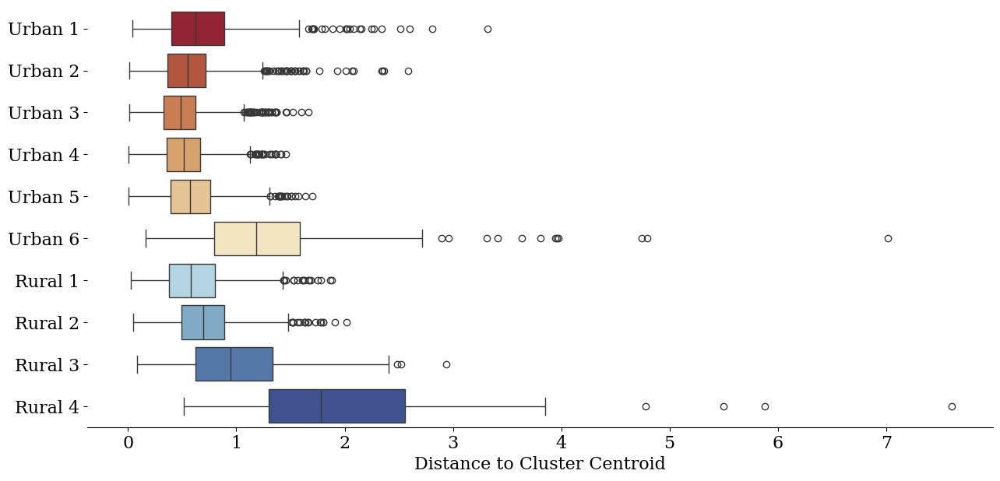

In [38]:
distances = km2.transform(X_cluster)
indices = km2.labels_
sample_distances = distances[np.arange(indices.size), indices]
df = pd.DataFrame(data={'Cluster': indices, 'Distance to Cluster Centroid': sample_distances})   
df['Cluster'] = df['Cluster'].map(km_2_map)
f, ax = plt.subplots(1, figsize=(15, 7))
sns.boxplot(data=df, y='Cluster', x='Distance to Cluster Centroid', order=sorter, ax=ax, palette=km2_cols)
ax.set_ylabel("")

# turn off all the spines
ax.spines['top'].set_visible(False)
# ax.spines['bottom'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['right'].set_visible(False)


f.savefig(OUT / 'cluster_distances.png', dpi=300, bbox_inches='tight')

In [39]:
g = gdf.groupby('cluster_name_km_2').msoa.count()
df_counts = pd.DataFrame(data={'Cluster': g.index, 'Count': g.values, '%': (100*g.values / gdf.shape[0]).round(1)}).sort_values(by="Cluster", key=lambda column: column.map(lambda e: sorter.index(e))).reset_index(drop=True)
df_counts.to_csv(OUT / 'cluster_counts.csv', index=False)
df_counts

,Cluster,Count,%
0,Urban 1,416,6.1
1,Urban 2,943,13.8
2,Urban 3,1489,21.7
3,Urban 4,1153,16.8
4,Urban 5,890,13.0
5,Urban 6,296,4.3
6,Rural 1,842,12.3
7,Rural 2,494,7.2
8,Rural 3,254,3.7
9,Rural 4,78,1.1


In [40]:
g = gdf.groupby('rural_urban_category').msoa.count()
pd.DataFrame(data={'Cluster': g.index, 'Count': g.values, '%': (100*g.values / gdf.shape[0]).round(1)})

,Cluster,Count,%
0,Rural town and fringe,591,8.6
1,Rural town and fringe in a sparse setting,20,0.3
2,Rural village and dispersed,541,7.9
3,Rural village and dispersed in a sparse setting,43,0.6
4,Urban city and town,2969,43.3
5,Urban city and town in a sparse setting,13,0.2
6,Urban major conurbation,2431,35.5
7,Urban minor conurbation,247,3.6


# Plot cluster centroids

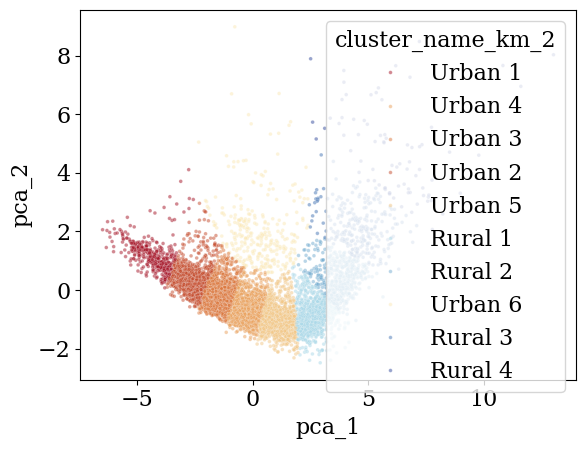

In [43]:
ax = sns.scatterplot(data=gdf_export, x='pca_1', y='pca_2', hue='cluster_name_km_2', 
                    alpha=0.5, s=7,
                    palette=km2_colmap,
                    # hue_order=sorter
                    )
# ax = sns.scatterplot(x=km2.cluster_centers_[:, 0], y=km2.cluster_centers_[:, 1],
#                      hue=range(10), s=20, ec='black', legend=False, ax=ax, palette=kmeans_colmap)
plt.show()

# Test values of K

In [44]:
gdf_km = gdf_export.drop(columns=['cluster_gmm', 'cluster_gmm_2',
       'cluster_km_1', 'cluster_name_gmm', 'cluster_color_gmm',
       'cluster_color_km_1', 'cluster_name_km_1', 'cluster_name_km_2',
       'cluster_color_km_2', 'cluster_km_2', 'cluster_color_defra'])
X_cluster = gdf_km[[
    f'pca_1', 
    f'pca_2', 
]].to_numpy()
km_dict = {}
sil_scores ={}
for k in range(2, 20):
    km = KMeans(
        n_clusters=k,
        n_init=20,
        random_state=42,
    )
    km.fit(X_cluster)
    clusters = km.predict(X_cluster)
    sil_scores[k] = silhouette_score(X_cluster, clusters)
    km_dict[k] = km
    gdf_km[f'cluster_km_{k}'] = clusters



In [45]:
# gdf_gmm = gdf_export.drop(columns=['cluster_gmm', 'cluster_gmm_2',
#        'cluster_km_1', 'cluster_name_gmm', 'cluster_color_gmm',
#        'cluster_color_km_1', 'cluster_name_km_1', 'cluster_name_km_2',
#        'cluster_color_km_2', 'cluster_km_2', 'cluster_color_defra'])
# X_cluster = gdf_km[[
#     f'pca_1', 
#     f'pca_2', 
# ]].to_numpy()
gmm_dict = {}
for k in [8, 9, 10, 11, 12]:
    gmm = GaussianMixture(
        n_components=k,
        n_init=20,
        random_state=42,
    )
    gmm.fit(X_cluster)
    clusters = gmm.predict(X_cluster)
    # print(silhouette_score(X_cluster, clusters))
    gmm_dict[k] = gmm
    gdf_km[f'cluster_gmm_{k}'] = clusters
